In [1]:
from analysis.analyze_results import *
from pathlib import Path
import matplotlib.pyplot as plt
import numpy as np
import matplotlib
from collections import defaultdict

In [2]:
# output_base_folder = Path("/home/ivan/Documents/git/storage-benchmarking/src/benchmark_output")
output_base_folder = Path("/iarai/home/ivan.svogor/git/storage-benchmarking/src/benchmark_output")

In [3]:
s3_folder_filter="1011_4/*benchmark_e2e*"
scratch_folder_filter="1111_5/*benchmark_e2e*"
# s3_folder_filter="2810/*benchmark_e2e*"

In [4]:
def extract_timelines(output_base_folder: Path, folder_filter: str = "**", filter_by_metadata: Dict[str, List[str]] = None,
):
    files = list(output_base_folder.rglob(f"{folder_filter}/timeline-*.log"))
    data = []
    for working_file_path in tqdm.tqdm(files, total=len(files)):
        results = parse_results_log(working_file_path)
        if len(results) == 0:
            continue
        results = pd.DataFrame.from_records(data=results)
        results = pd.merge(results[results["end_time"].isnull()], 
                           results[results["start_time"].isnull()], 
                           left_on='id', 
                           right_on='id').drop(['end_time_x', 'start_time_y'], axis=1)
        results["source_file"] = working_file_path
        results["run"] = working_file_path.parent.name
        # filter out old data format missing dataset etc.
        data.append(results)
    df = pd.concat(data)
    df.groupby
    return df


In [5]:
def show_timelines(df, run, flat=False, zoom=False, zoom_epochs = 1):
    fig, ax = plt.subplots(figsize=(30, 20))
    # fig, ax = plt.subplots()
    data = defaultdict(list)
    start = min(df["start_time_x"]) 
    end = max(df["end_time_y"])
    
    total_runtime = (end - start)
    number_of_epochs = 20
    
    if zoom:
        df = df[df["start_time_x"] < start+((total_runtime / number_of_epochs) * zoom_epochs)]
    
    i = 0
    for index, row in df.sort_values(["start_time_x"], ascending=True).iterrows():
        duration = row["end_time_y"] - row["start_time_x"] 
        x1 = row["start_time_x"] - start 
        if duration < 0.08:
            duration = 0.1
        x2 = x1 + duration
        if not flat:
            lane = i
            i += 1
        else:
            lane = lanes[row["item_x"]]
        ax.plot([x1, x2], [lane, lane], color=colors[row["item_x"]], label=row["item_x"], linewidth=1)
    ax.set_xlabel("Experiment duration", loc="center")
    ax.set_ylabel("Item", loc="top")
    # print(run.split('_'))
    # ['20211109f152412', 'benchmark', 'e2e', 'lightning', 's3', '256', '4', '16', '1', 'vanilla', 'sync']
    filename = run.split('_')
    ax.set_title(f"Runtime for each function, impl: {filename[9]},"
                 f" cache: {filename[8]}, "
                 f" batch size: {filename[5]}, "
                 f" lib: {filename[3]}",
                 loc='center')
    ax.legend()
    ax.grid(linestyle='--', which="both")

    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))

    # Put a legend below current axis
    ax.legend(by_label.values(), by_label.keys(), 
              loc='upper center', bbox_to_anchor=(0.5, -0.05),
              fancybox=True, shadow=True, ncol=5)
    plt.show()


In [6]:
df_dataloader_s3 = extract_timelines(output_base_folder, folder_filter=s3_folder_filter)
df_dataloader_scratch = extract_timelines(output_base_folder, folder_filter=scratch_folder_filter)


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 426/426 [00:21<00:00, 19.83it/s]


In [7]:
df_dataloader_s3.sort_values(["start_time_x"], ascending=False)

,item_x,id,start_time_x,item_y,end_time_y,source_file,run
3541,run_training_batch,9.012016e+18,1.636635e+09,run_training_batch,1.636635e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f031032_benchmark_e2e_lightning_s3_256...
3540,training_batch_to_device,4.991147e+18,1.636635e+09,training_batch_to_device,1.636635e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f031032_benchmark_e2e_lightning_s3_256...
3539,next_data,1.179000e+03,1.636635e+09,next_data,1.636635e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f031032_benchmark_e2e_lightning_s3_256...
3538,run_training_batch,4.491218e+18,1.636635e+09,run_training_batch,1.636635e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f031032_benchmark_e2e_lightning_s3_256...
3537,training_batch_to_device,6.003103e+18,1.636635e+09,training_batch_to_device,1.636635e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f031032_benchmark_e2e_lightning_s3_256...
...,...,...,...,...,...,...,...
0,batch,1.636583e+09,1.636583e+09,batch,1.636583e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211110f232825_benchmark_e2e_torch_s3_256_4_1...
0,batch,1.636583e+09,1.636583e+09,batch,1.636583e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211110f232825_benchmark_e2e_torch_s3_256_4_1...
1,batch,1.636583e+09,1.636583e+09,batch,1.636583e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211110f232825_benchmark_e2e_torch_s3_256_4_1...
0,batch,1.636583e+09,1.636583e+09,batch,1.636583e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211110f232825_benchmark_e2e_torch_s3_256_4_1...


In [8]:
df_dataloader_scratch.sort_values(["start_time_x"], ascending=False)

,item_x,id,start_time_x,item_y,end_time_y,source_file,run
3549,run_training_batch,5.347879e+18,1.636666e+09,run_training_batch,1.636666e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f215633_benchmark_e2e_lightning_scratc...
3548,training_batch_to_device,5.617878e+18,1.636666e+09,training_batch_to_device,1.636666e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f215633_benchmark_e2e_lightning_scratc...
3547,next_data,1.179000e+03,1.636666e+09,next_data,1.636666e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f215633_benchmark_e2e_lightning_scratc...
3546,run_training_batch,5.396782e+18,1.636666e+09,run_training_batch,1.636666e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f215633_benchmark_e2e_lightning_scratc...
3545,training_batch_to_device,1.366212e+18,1.636666e+09,training_batch_to_device,1.636666e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f215633_benchmark_e2e_lightning_scratc...
...,...,...,...,...,...,...,...
0,batch,1.636661e+09,1.636661e+09,batch,1.636661e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f205911_benchmark_e2e_torch_scratch_25...
0,batch,1.636661e+09,1.636661e+09,batch,1.636661e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f205911_benchmark_e2e_torch_scratch_25...
1,batch,1.636661e+09,1.636661e+09,batch,1.636661e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f205911_benchmark_e2e_torch_scratch_25...
0,batch,1.636661e+09,1.636661e+09,batch,1.636661e+09,/iarai/home/ivan.svogor/git/storage-benchmarki...,20211111f205911_benchmark_e2e_torch_scratch_25...


In [9]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999

<IPython.core.display.Javascript object>

In [10]:
unique_functions_s3 = np.unique(df_dataloader_s3["item_x"])
print(f"Unique functions: {unique_functions_s3}")

colors = {}
for i, color in zip(unique_functions_s3, ["red", "gold", "blue", "magenta", "aqua"]):
    colors[str(i)] = color
lanes={}
for i, lane in zip(unique_functions_s3, range(len(unique_functions_s3))):
    lanes[str(i)] = lane
    
print(f"Lanes: {lanes}")
    
#df_dataloader = extract_timelines(output_base_folder, folder_filter=s3_folder_filter)

unique_runs_s3 = np.unique(df_dataloader_s3["run"])
unique_runs_scratch = np.unique(df_dataloader_scratch["run"])

Unique functions: ['batch' 'next_data' 'run_training_batch' 'training_batch_to_device']
Lanes: {'batch': 0, 'next_data': 1, 'run_training_batch': 2, 'training_batch_to_device': 3}


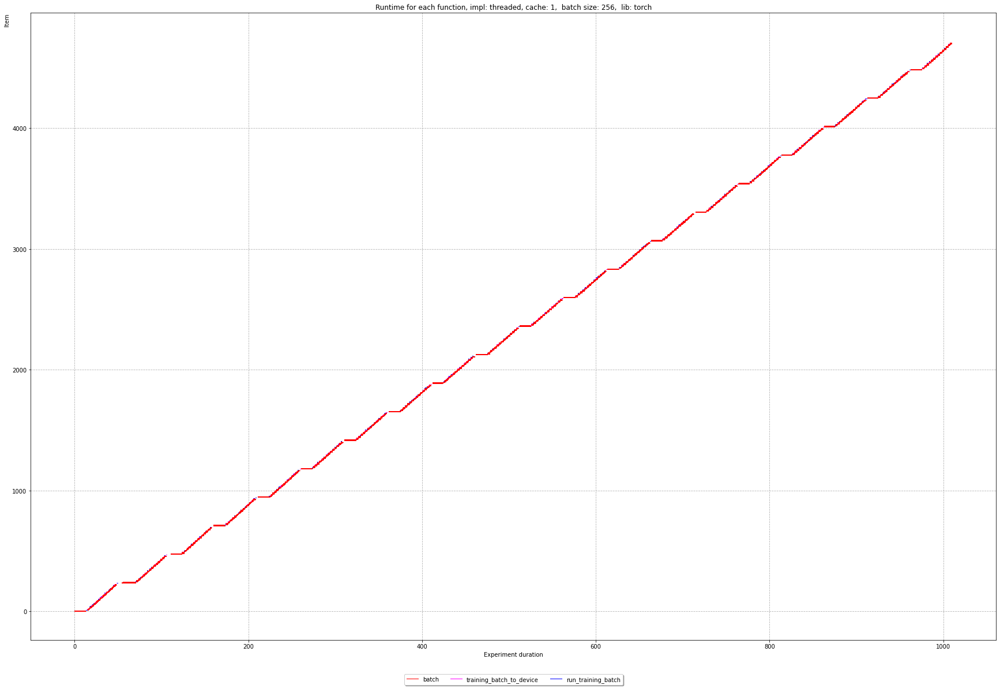

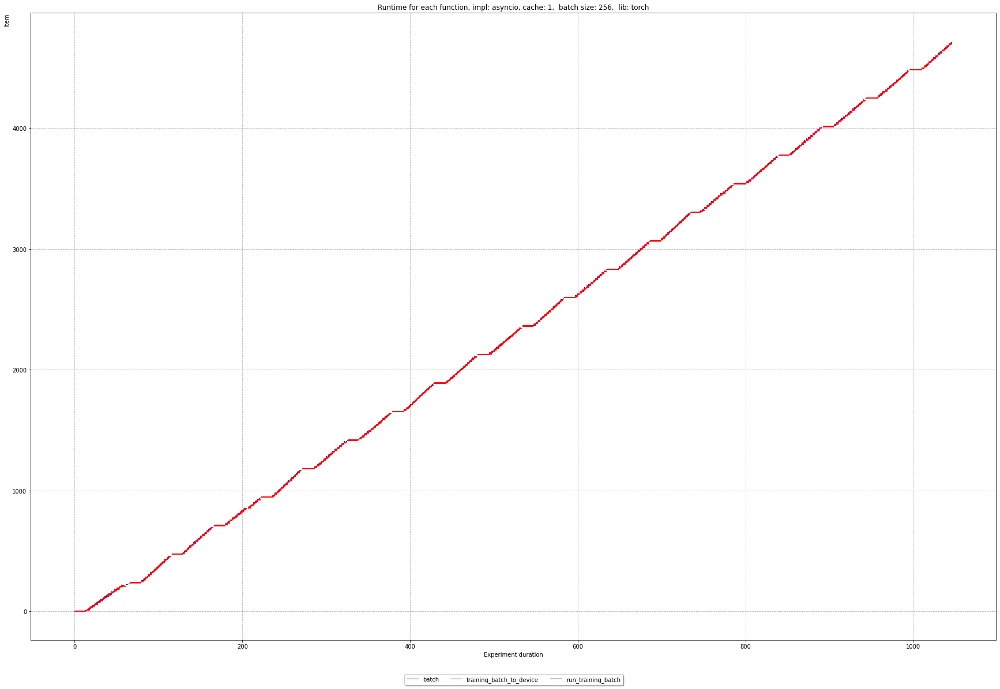

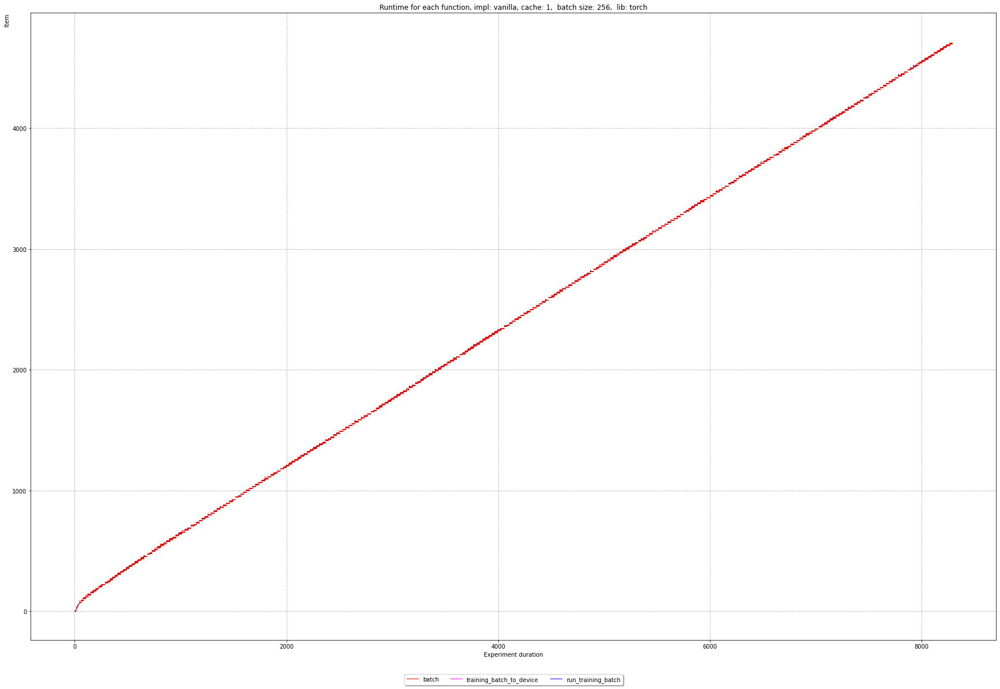

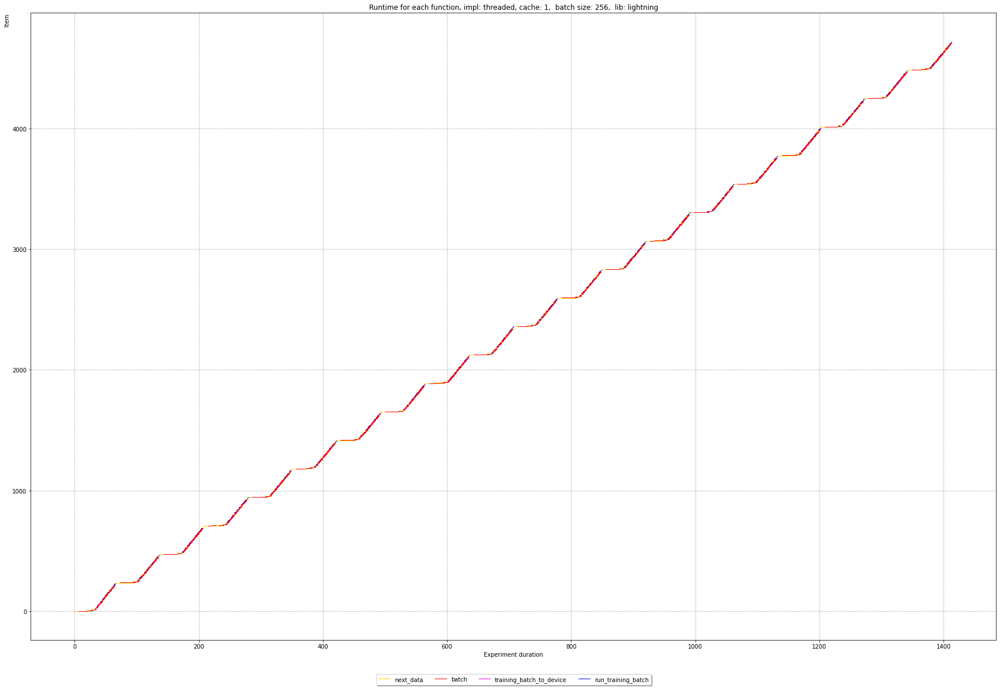

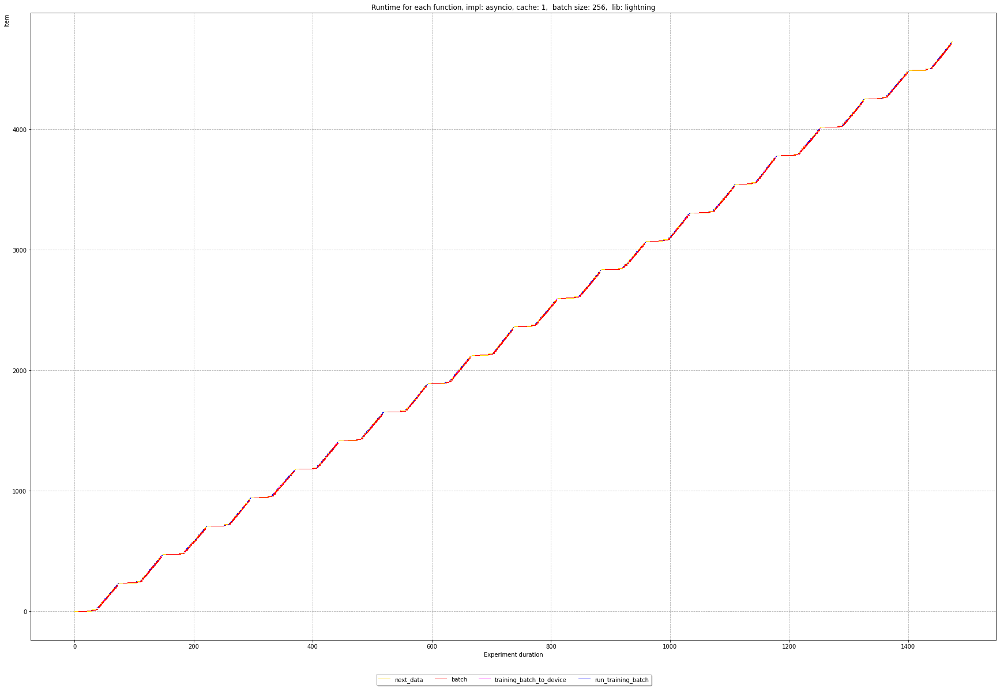

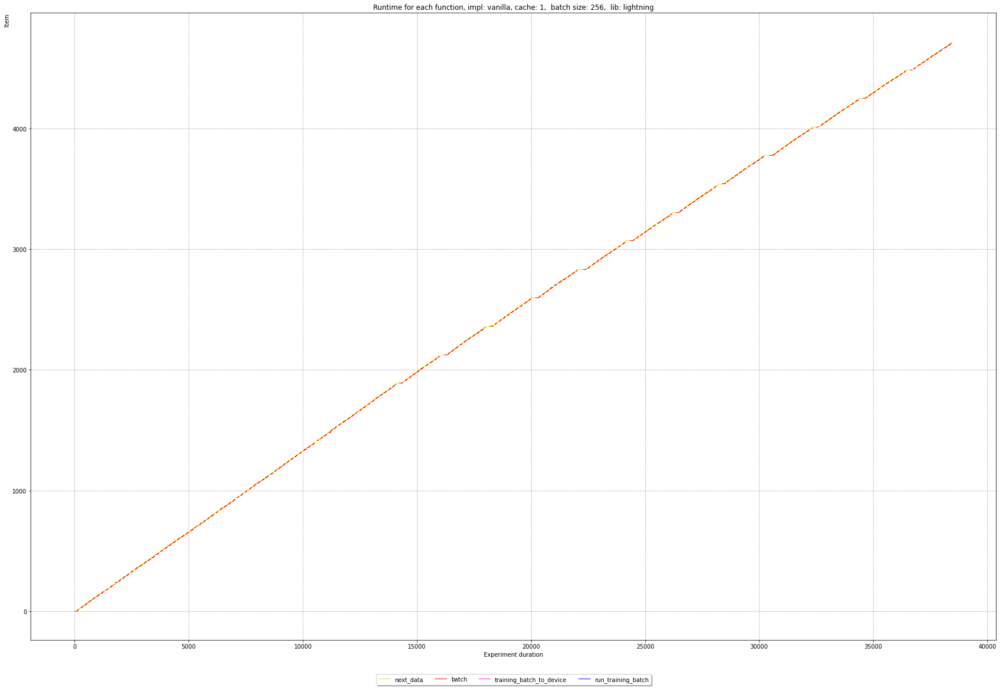

In [11]:
for implementation in ["torch", "lightning"]:
    for run in unique_runs_s3:
        if implementation in run:
            df = df_dataloader_s3[(df_dataloader_s3["run"]==run)]
            show_timelines(df, run, False, False, 1)

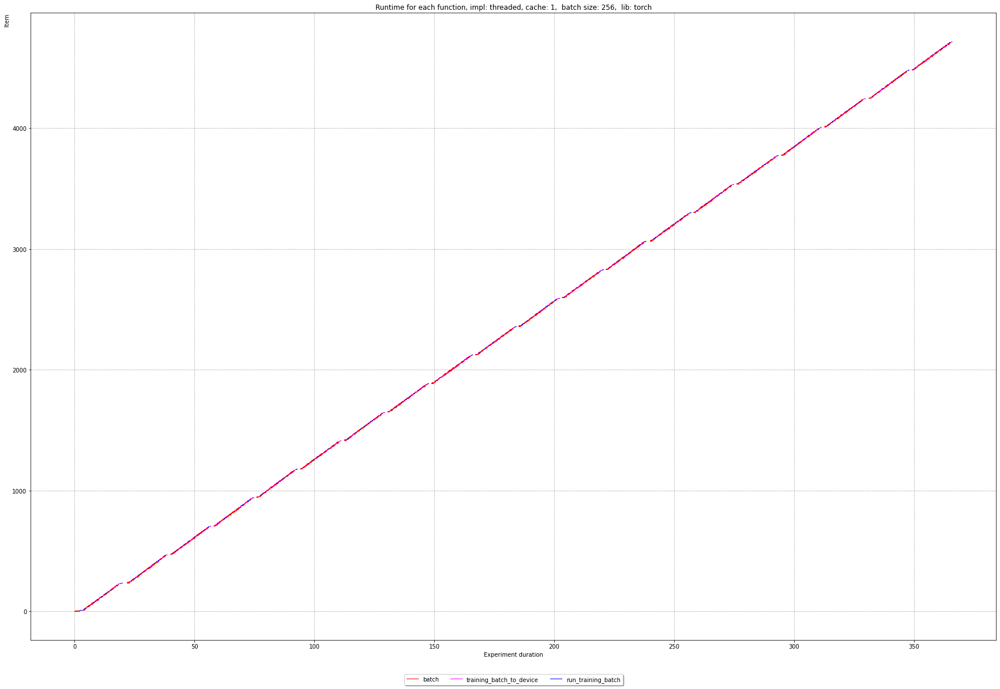

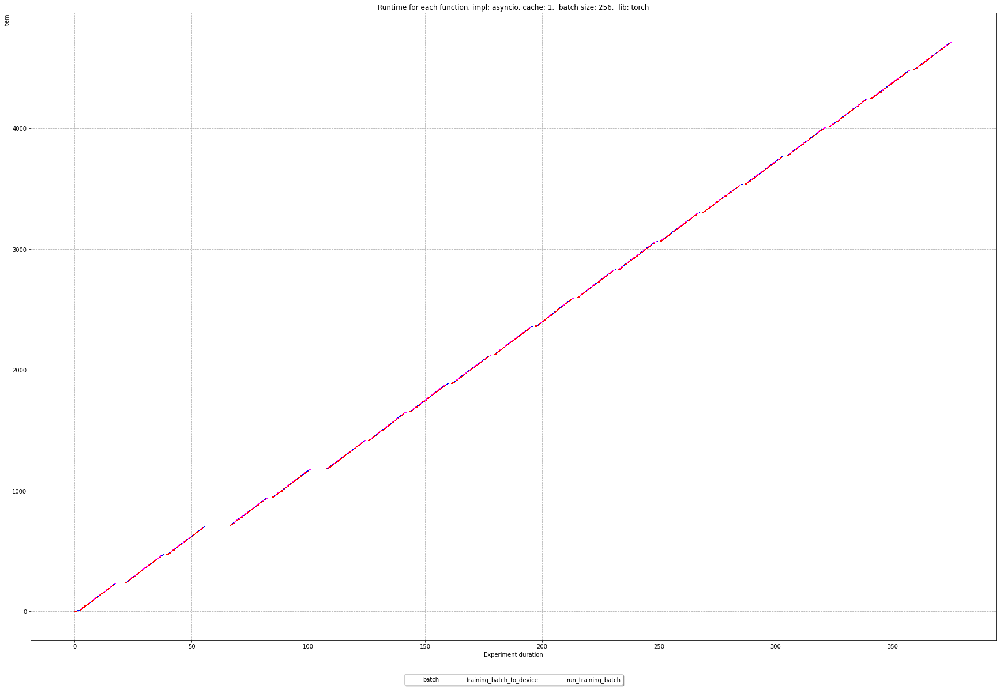

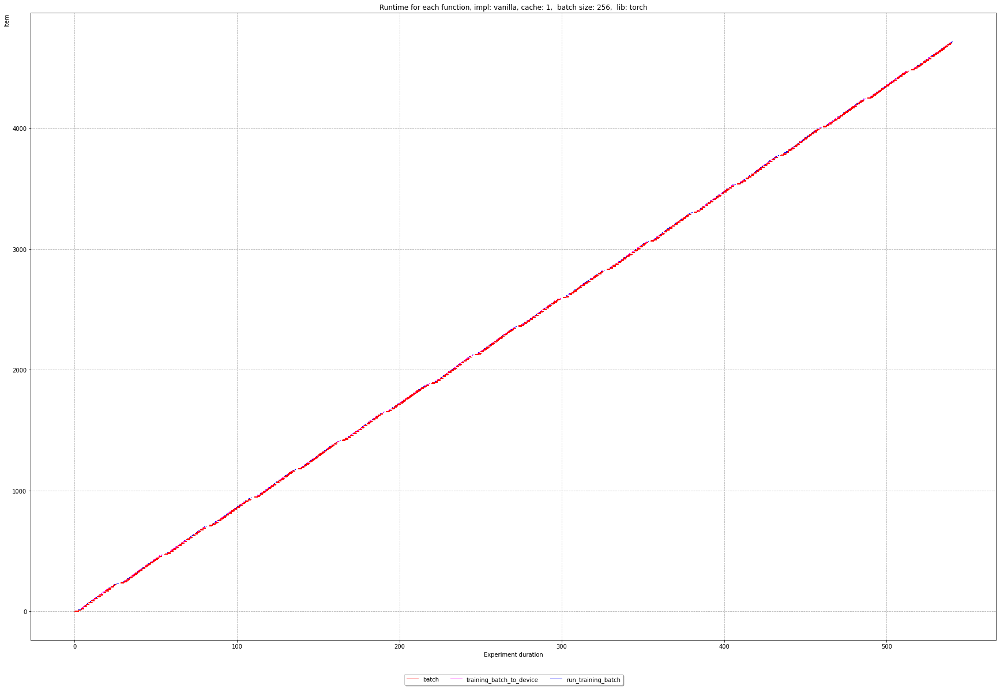

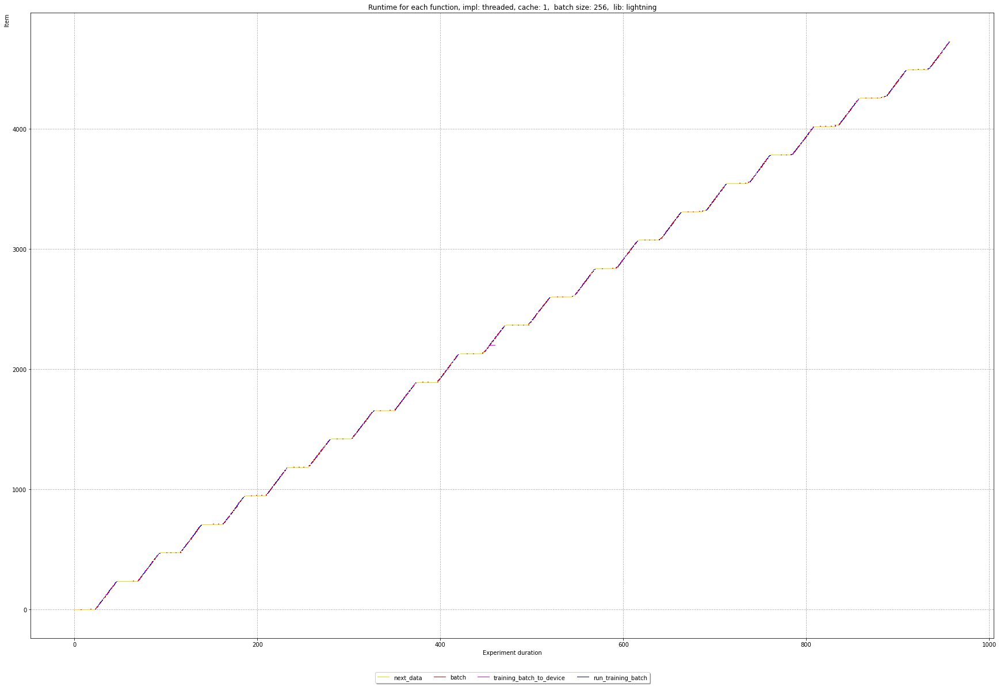

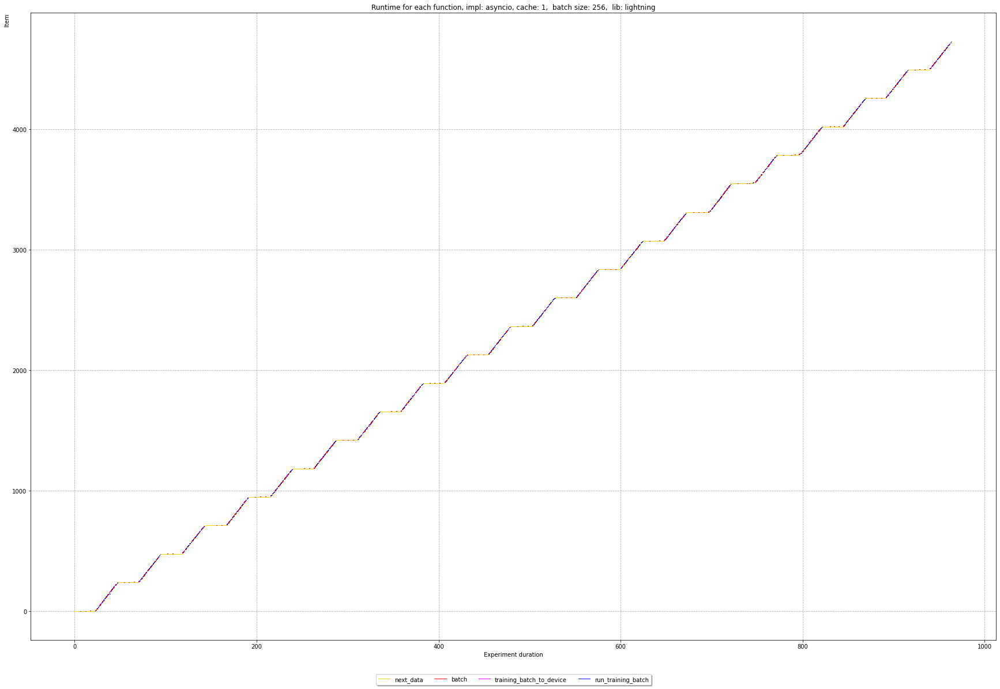

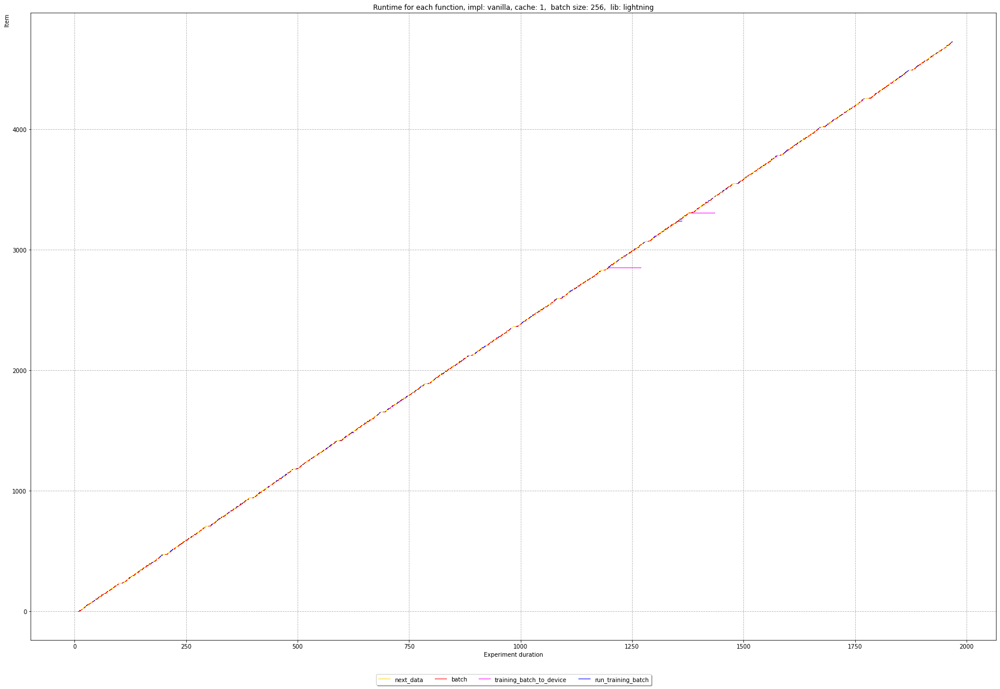

In [12]:
for implementation in ["torch", "lightning"]:
    for run in unique_runs_scratch:
        if implementation in run:
            df = df_dataloader_scratch[(df_dataloader_scratch["run"]==run)]
            show_timelines(df, run, False, False, 1)

In [13]:
def extract_gpuutil(output_base_folder: Path, folder_filter: str = "**", filter_by_metadata: Dict[str, List[str]] = None,
):
    files = list(output_base_folder.rglob(f"{folder_filter}/gpuutil-*.log"))
    data = []
    for working_file_path in tqdm.tqdm(files, total=len(files)):
        results = parse_results_log(working_file_path)
        if len(results) == 0:
            continue
        header = []
        header.append("timestamp")
        for i in results[0]["gpu_data"]:
            header.append(f"gpu_util_{i}")
            header.append(f"mem_util_{i}")
        header.append("run")
        lines = []
        for result in results:
            line = []
            line.append(result["timestamp"])
            for item in result["gpu_data"]:
                line.append(result["gpu_data"][item]["gpu_util"])
                line.append(result["gpu_data"][item]["mem_util"])
            line.append(working_file_path.parent.name)
            lines.append(line)
        results = pd.DataFrame.from_records(lines)
        data.append(results)
    df = pd.concat(data)
    df.columns = header
    df.groupby
    df.sort_values(["timestamp"], ascending=True)
    return df

In [14]:
df_gpuutil_s3 = extract_gpuutil(output_base_folder, folder_filter=s3_folder_filter)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 425/425 [00:18<00:00, 23.54it/s]


In [15]:
df_gpuutil_scratch = extract_gpuutil(output_base_folder, folder_filter=scratch_folder_filter)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 426/426 [00:17<00:00, 24.45it/s]


In [16]:
unique_runs_s3 = np.unique(df_dataloader_s3["run"])

In [17]:
unique_runs_scratch = np.unique(df_dataloader_scratch["run"])

In [18]:
print(unique_runs_s3, unique_runs_scratch)

['20211110f232825_benchmark_e2e_torch_s3_256_4_16_1_threaded_sync'
 '20211110f234524_benchmark_e2e_lightning_s3_256_4_16_1_threaded_sync'
 '20211111f000909_benchmark_e2e_torch_s3_256_4_16_1_asyncio_sync'
 '20211111f002644_benchmark_e2e_lightning_s3_256_4_16_1_asyncio_sync'
 '20211111f005129_benchmark_e2e_torch_s3_256_4_16_1_vanilla_sync'
 '20211111f031032_benchmark_e2e_lightning_s3_256_4_16_1_vanilla_sync'] ['20211111f205911_benchmark_e2e_torch_scratch_256_4_16_1_threaded_sync'
 '20211111f210705_benchmark_e2e_lightning_scratch_256_4_16_1_threaded_sync'
 '20211111f212315_benchmark_e2e_torch_scratch_256_4_16_1_asyncio_sync'
 '20211111f213057_benchmark_e2e_lightning_scratch_256_4_16_1_asyncio_sync'
 '20211111f214714_benchmark_e2e_torch_scratch_256_4_16_1_vanilla_sync'
 '20211111f215633_benchmark_e2e_lightning_scratch_256_4_16_1_vanilla_sync']


In [38]:
def show_timelines_with_gpu(df, gpu_util, run, flat=False, show_gpu=False, zoom=False, zoom_epochs = 1):
    fig, ax = plt.subplots(figsize=(30, 25))
    # fig, ax = plt.subplots()
    plt.rcParams.update({'font.size': 18})
    data = defaultdict(list)
    start = min(df["start_time_x"]) 
    end = max(df["end_time_y"]) 
    gpu_start = min(gpu_util["timestamp"])
    gpu_end = max(gpu_util["timestamp"])
    
    total_runtime = (end - start)
    number_of_epochs = 20
    
    if zoom:
        df = df[df["start_time_x"] < start+((total_runtime / number_of_epochs) * zoom_epochs)]
        gpu_util = gpu_util[gpu_util["timestamp"] < gpu_start+((total_runtime / number_of_epochs) * zoom_epochs)]
    
    lane = 0
    for index, row in df.sort_values(["start_time_x"], ascending=True).iterrows():
        duration = row["end_time_y"] - row["start_time_x"] 
        x1 = row["start_time_x"] - start 
        if duration < 0.15:
            duration = 0.2
        x2 = x1 + duration
        if not flat:
            lane += 10
        else:
            lane = lanes[row["item_x"]]
        ax.plot([x1, x2], [lane, lane], color=colors[row["item_x"]], label=row["item_x"], linewidth=3)
    

    ax.set_xlabel("Experiment duration (S)", loc="right")
    ax.set_ylabel("Operation activity lane", loc="center")
    filename = run.split('_')

    
    ax.legend()
    ax.grid(linestyle='--', which="both")

    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))

    # Put a legend below current axis
    ax.legend(by_label.values(), by_label.keys(), 
              loc='upper center', bbox_to_anchor=(0.5, -0.05),
              fancybox=True, shadow=True, ncol=5)
    
    gpu_util_mean = 0
    gpu_util_mean_no_zeros = 0
    
    if show_gpu:
        ax2 = ax.twinx() 
        ax2.set_ylabel('GPU/Memory utilization (green, maroon)')
        
        r'{\fontsize{50pt}{3em}\selectfont{}a}{\fontsize{20pt}{3em}\selectfont{}N'
        ax2.set_ylim([-3, 103])
        gpu_events = []
        for i in gpu_util["timestamp"]:
            gpu_events.append(i - start)
        ax2.plot(gpu_events, gpu_util["gpu_util_2"], color="cyan", linestyle="--", linewidth=2)
        ax2.plot(gpu_events, gpu_util["mem_util_2"], color="maroon", linestyle="--", linewidth=2)
        gpu_util_zeros = (len(gpu_util[gpu_util['gpu_util_2'] == 0]['gpu_util_2']) / len(gpu_util['gpu_util_2'])) * 100        
        gpu_util_mean_no_zeros = np.mean(gpu_util[gpu_util['gpu_util_2'] > 0]['gpu_util_2']) 
        mem_util_mean = np.mean(gpu_util['mem_util_2'])
        mem_util_mean_no_zeros = np.mean(gpu_util[gpu_util['mem_util_2'] > 0]['mem_util_2']) 
        ax2.plot(gpu_events, [gpu_util_mean_no_zeros]*len(gpu_events), label='GPU Util Mean', linewidth=2, color='cyan')
        ax2.plot(gpu_events, [mem_util_mean_no_zeros]*len(gpu_events), label='Mem Util Mean', linewidth=2, color='maroon')
        print(gpu_util_mean_no_zeros, mem_util_mean_no_zeros)
        
        
    ax.set_title(f"Total runtime per operation \n Implementation: {filename[9]},"
             #f" use cache: {filename[8]}, "
             f" batch size: {filename[5]}, "
             f" library: {filename[3]}, "
             f"\n GPU unused: {round(gpu_util_zeros, 2)} %, "
             f" mean GPU usage: {round(gpu_util_mean_no_zeros, 2)} %",
             loc='center')

    plt.show()
    return {"runtime": end-start, 
            "gpu_util_zero": gpu_util_zeros, 
            "gpu_util_mean_no_zeros": gpu_util_mean_no_zeros, 
            "mem_util_mean": mem_util_mean, 
            "mem_util_mean_no_zeros": mem_util_mean_no_zeros, 
            "implementation": filename[9],
            "library": filename[3]
           }

60.22837370242215 38.17307692307692


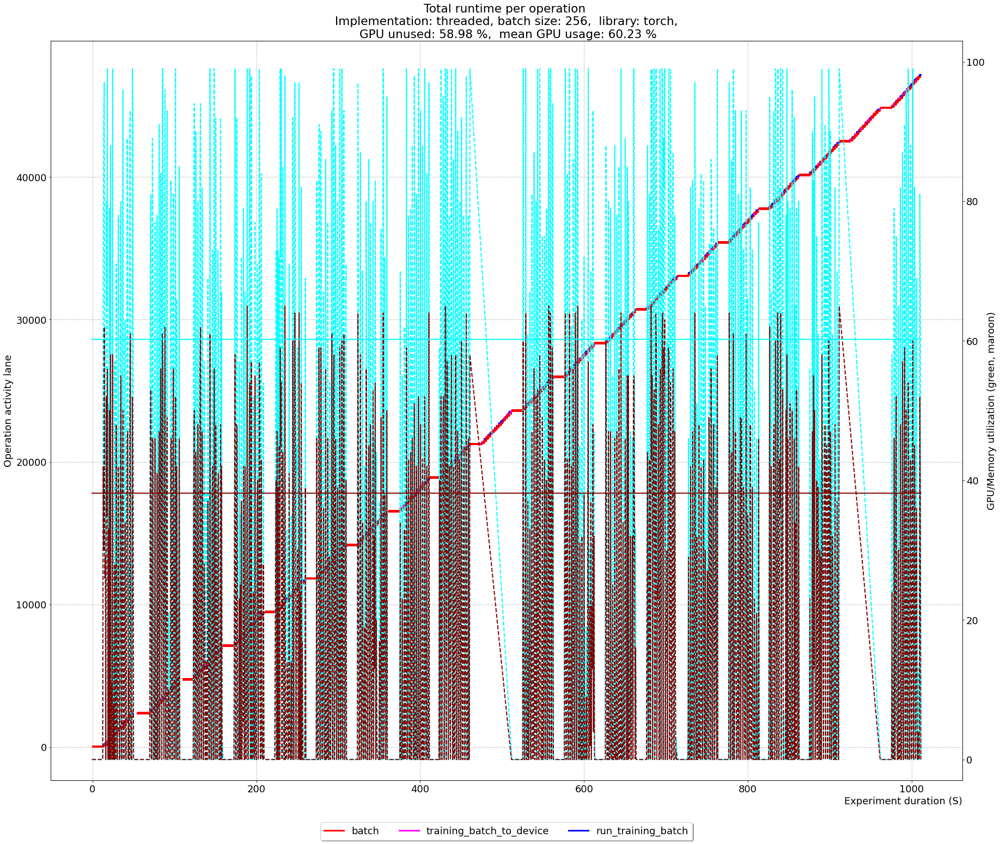

60.59310344827586 23.477631578947367


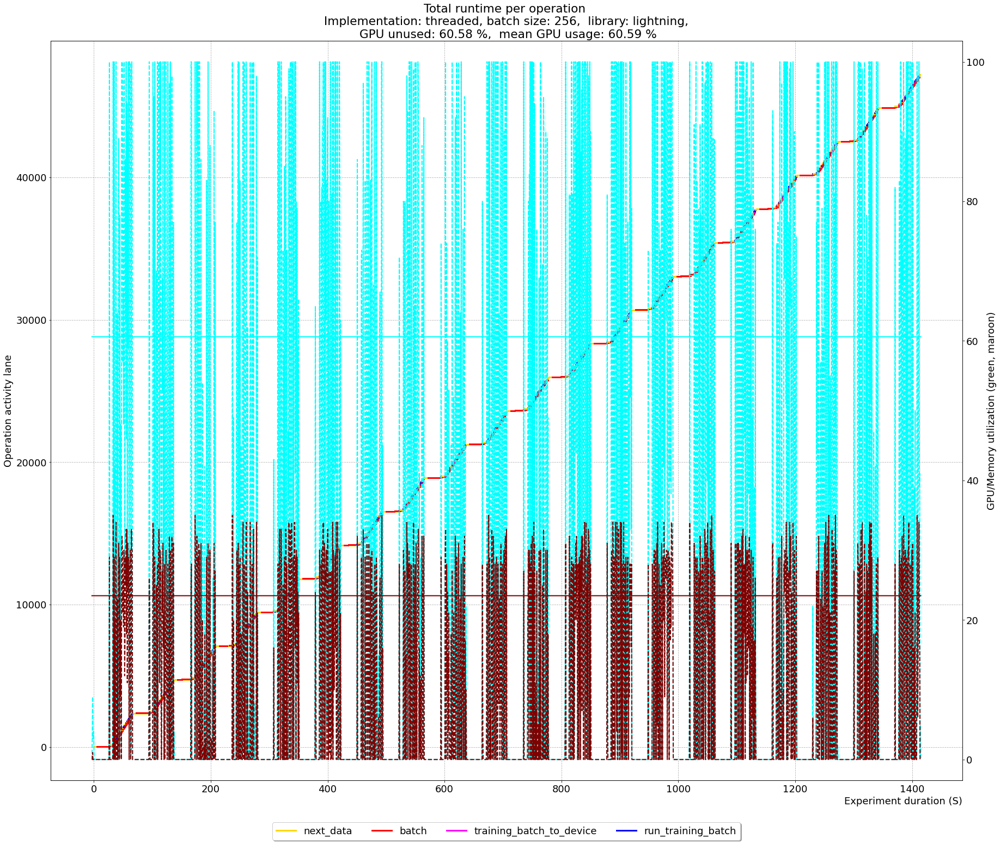

59.58178752107926 36.58646616541353


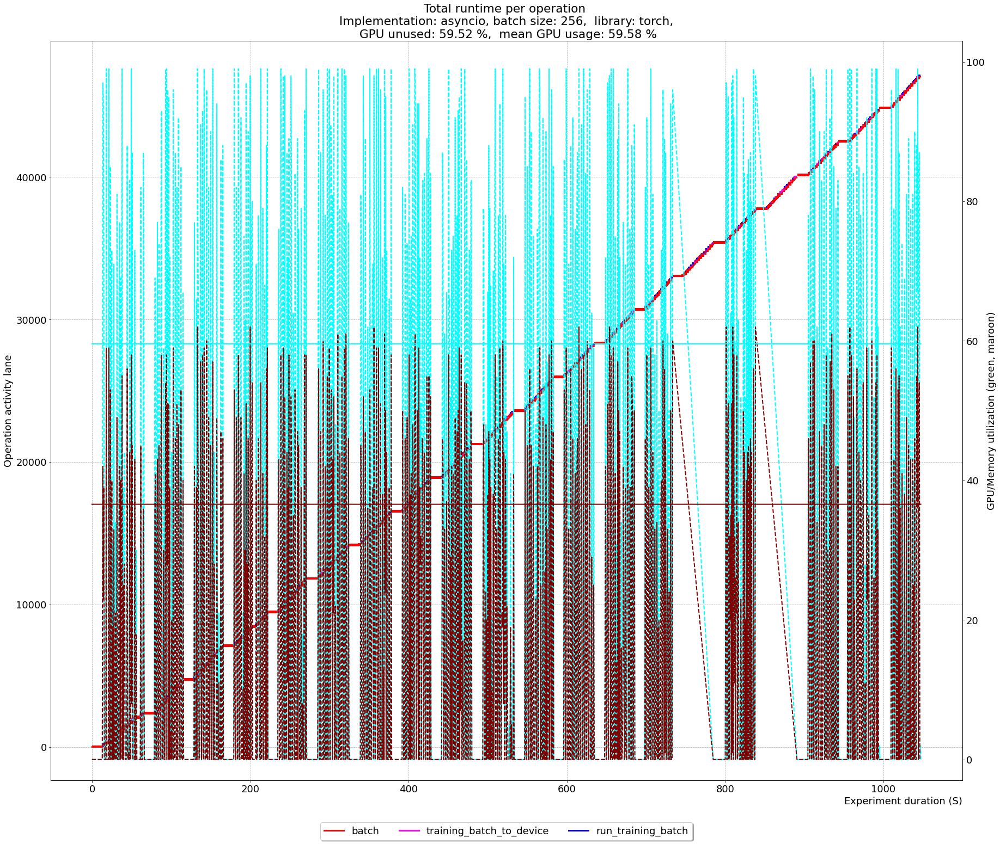

63.82468281430219 23.541984732824428


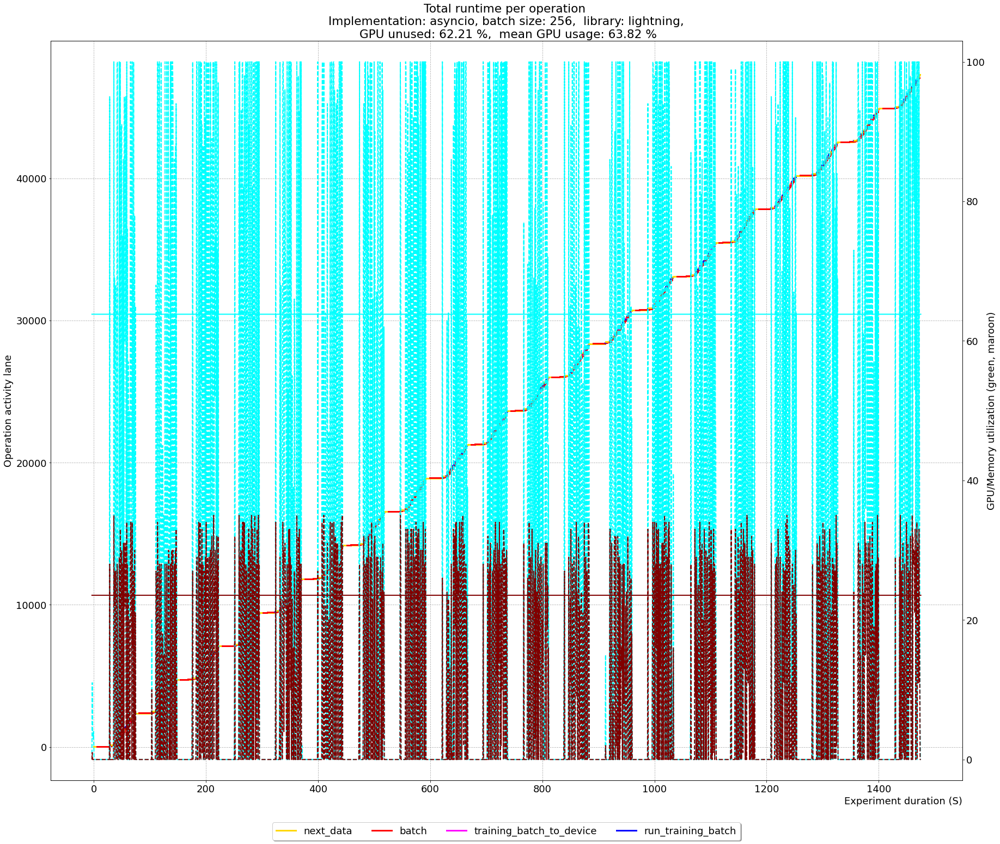

64.19565217391305 38.1588785046729


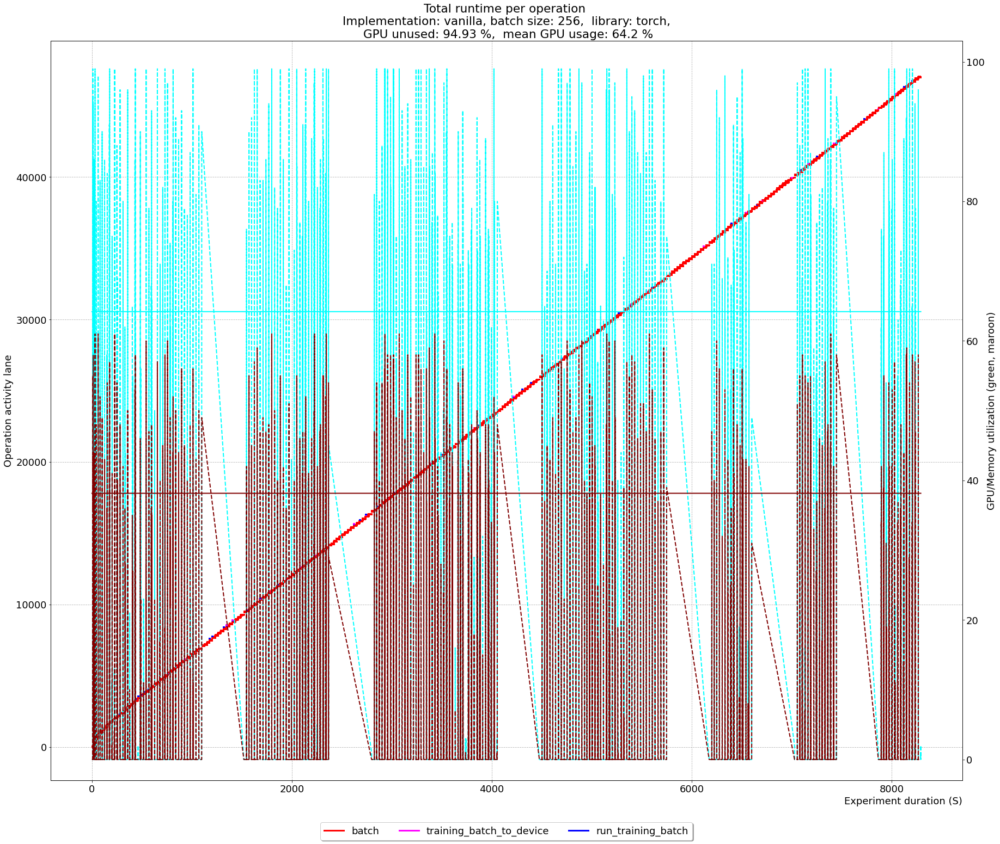

61.57286995515695 22.6875


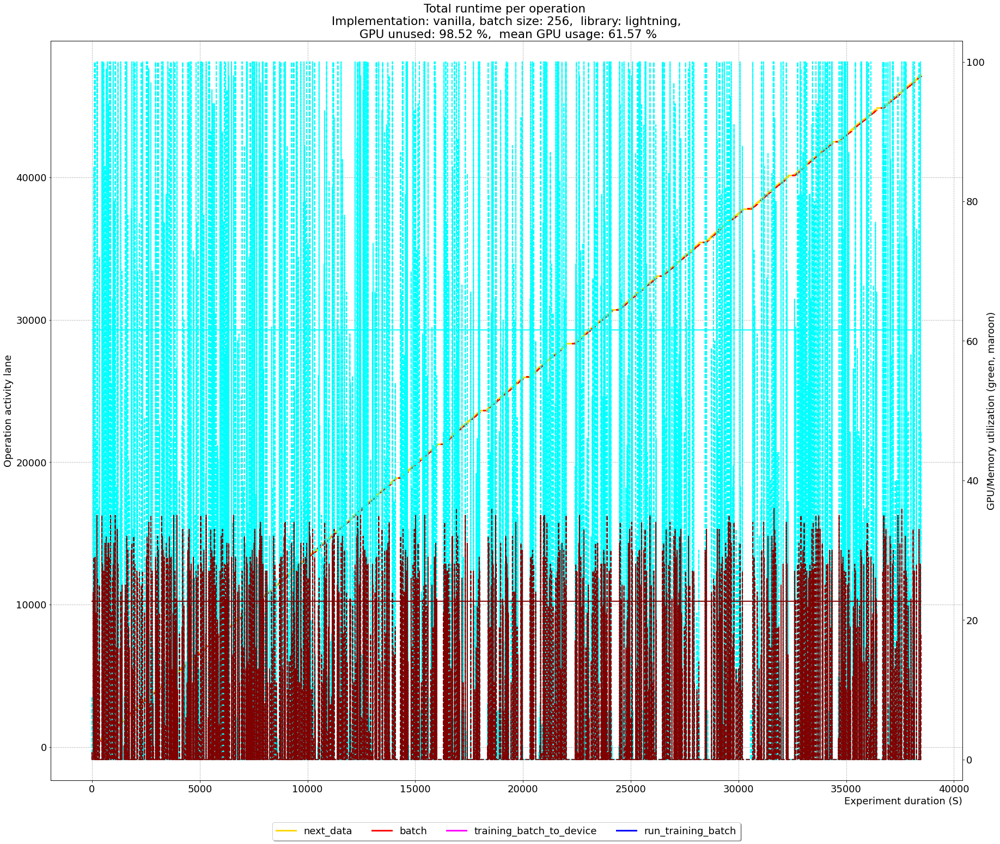

In [40]:
returns_s3 = []
for run in sorted(unique_runs_s3):
    df = df_dataloader_s3[df_dataloader_s3["run"]==run]
    dfgpu = df_gpuutil_s3[df_gpuutil_s3["run"]==run]
    returns_s3.append(show_timelines_with_gpu(df, dfgpu, run, False, True, False, 2))

In [34]:
%%javascript
IPython.OutputArea.auto_scroll_threshold = 9999

<IPython.core.display.Javascript object>

76.32101167315174 45.33864541832669


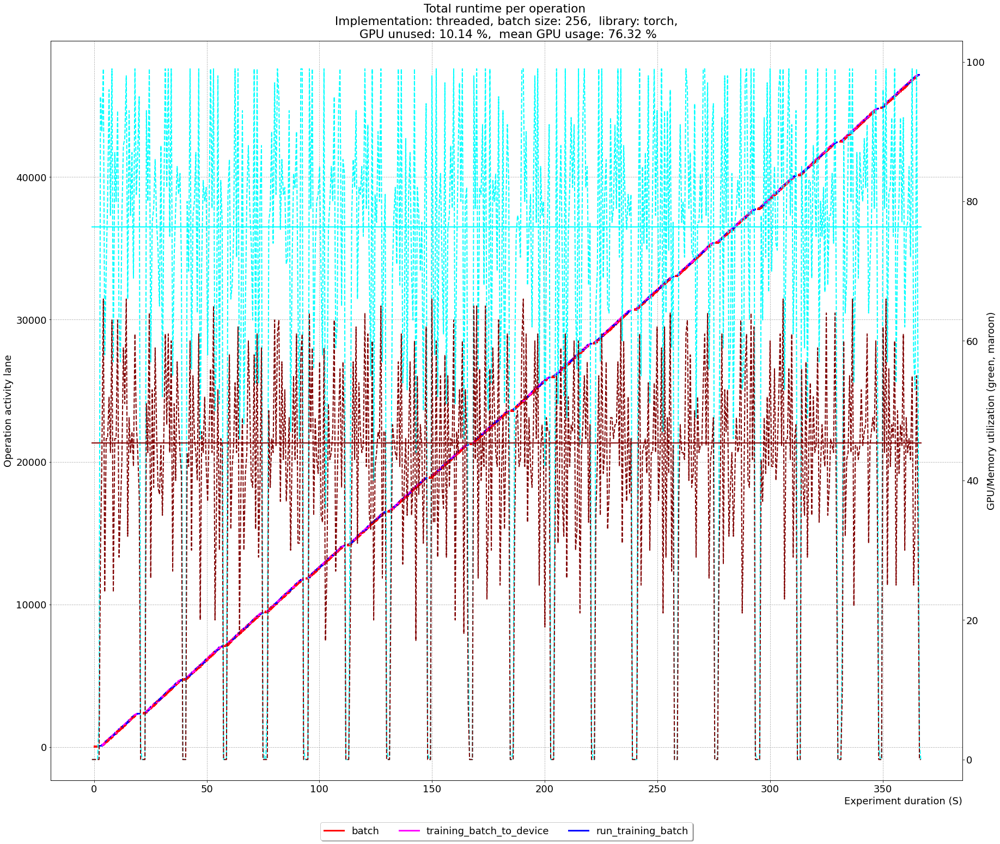

70.94504021447722 25.30056179775281


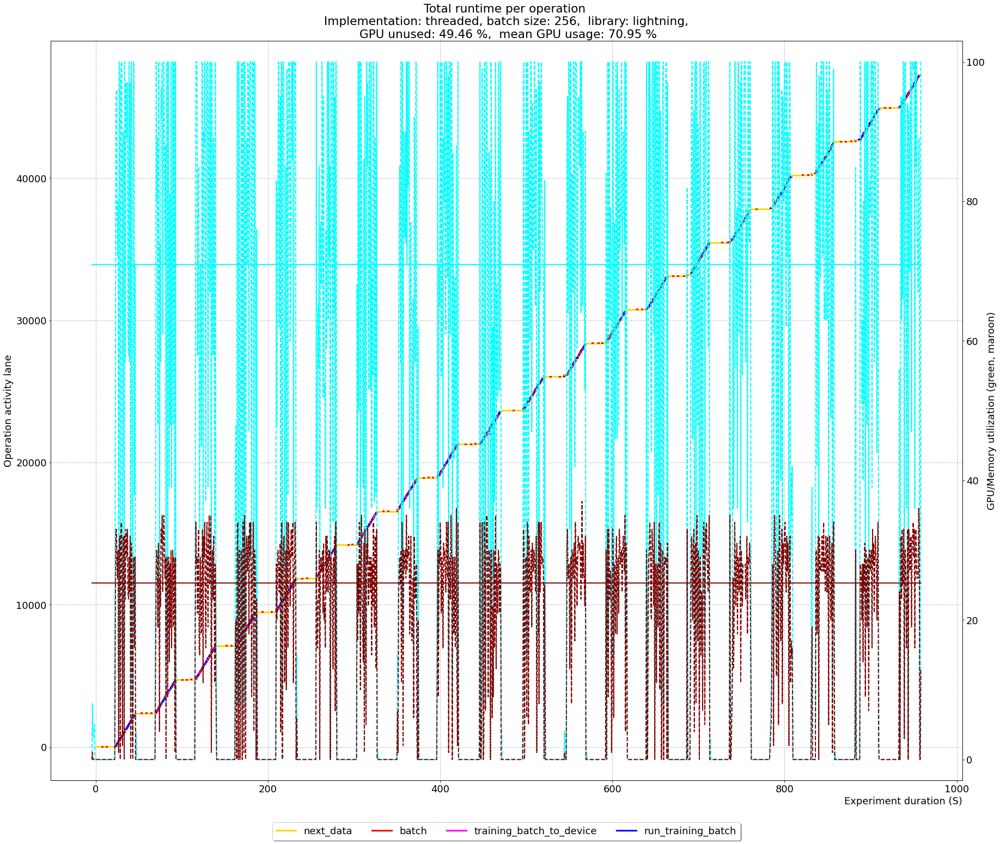

76.03017241379311 44.213656387665196


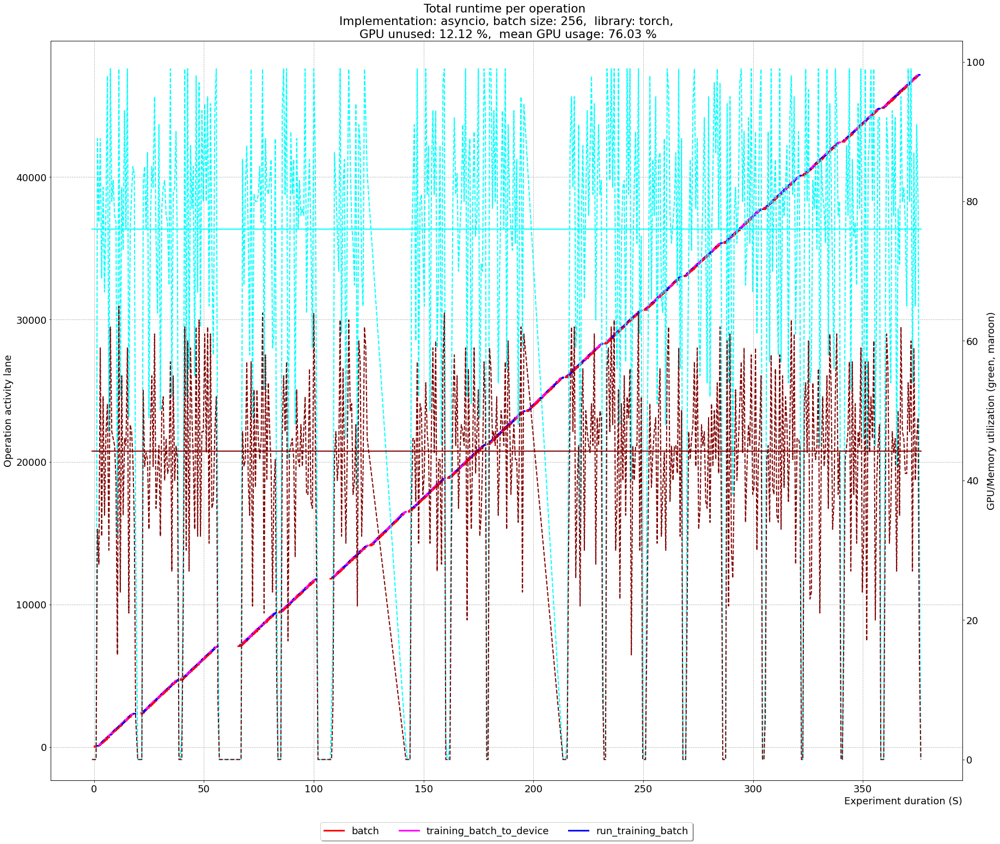

68.76962676962677 24.46565934065934


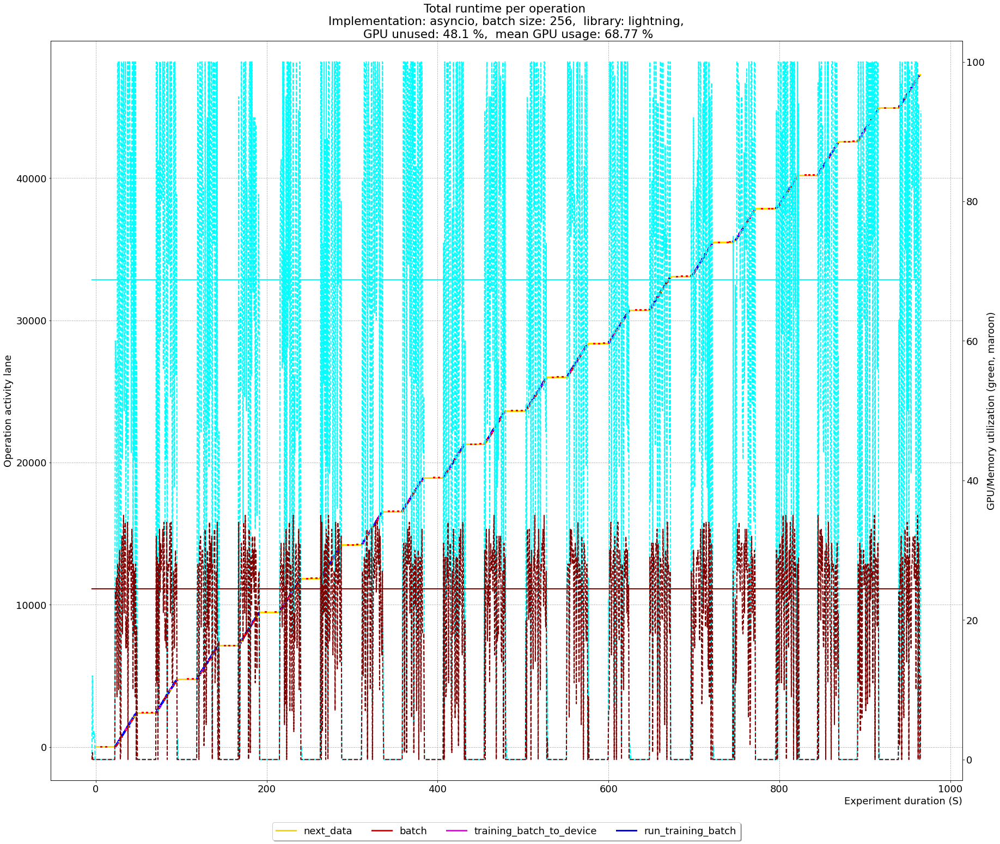

68.44339622641509 40.86138613861386


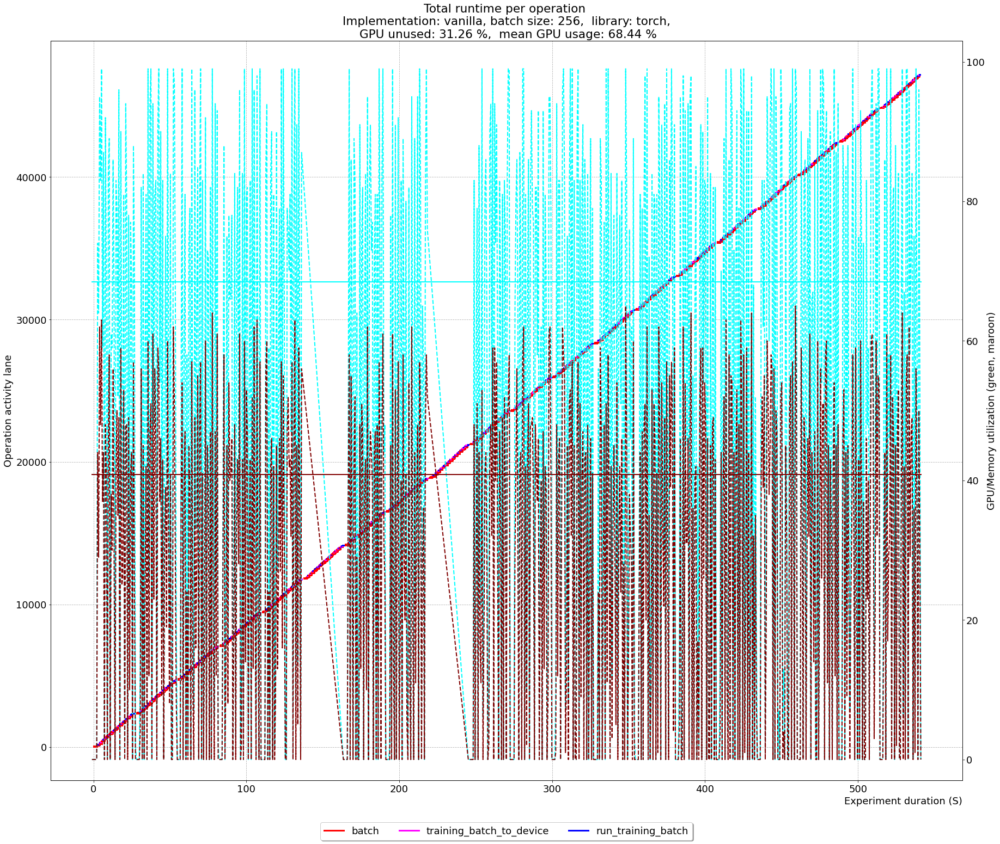

61.127272727272725 22.660756501182032


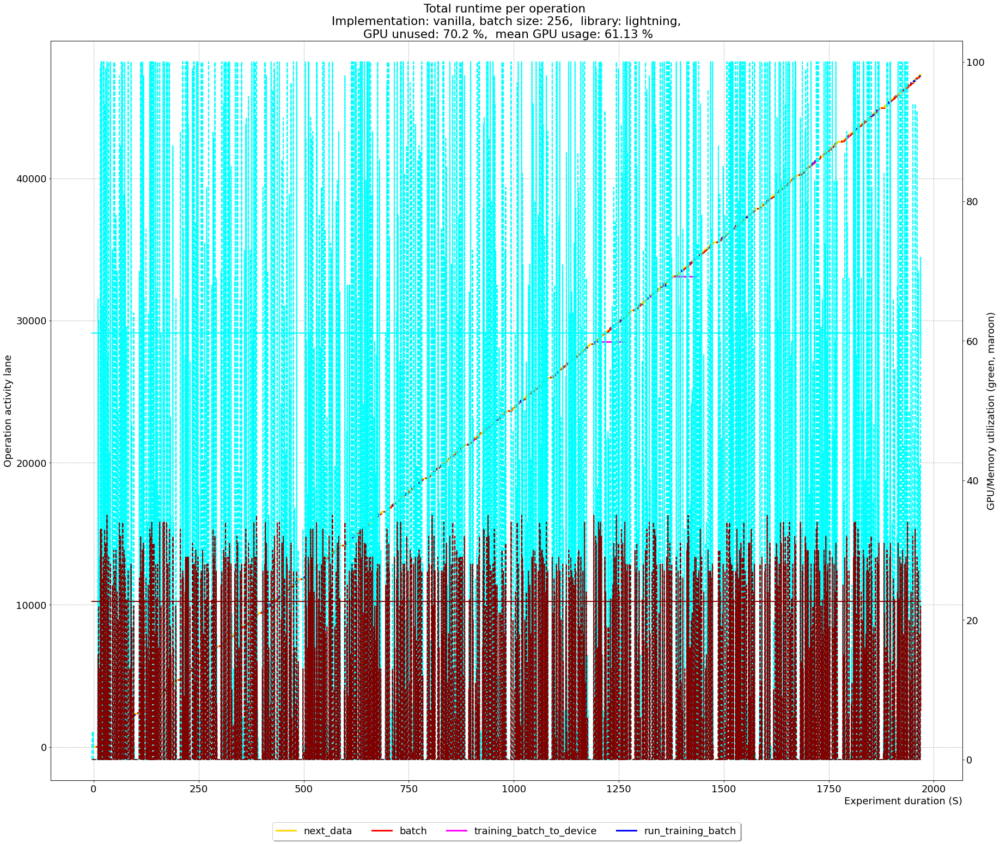

In [41]:
returns_scratch = []
for run in sorted(unique_runs_scratch):
    df = df_dataloader_scratch[df_dataloader_scratch["run"]==run]
    dfgpu = df_gpuutil_scratch[df_gpuutil_scratch["run"]==run]
    returns_scratch.append(show_timelines_with_gpu(df, dfgpu, run, False, True, False, 1))

In [45]:
results = pd.DataFrame.from_records(data=returns_s3)
samples = 15000
results["throughput"] = 15000 / results["runtime"]
results.sort_values(["runtime", "library"], ascending=True)

,runtime,gpu_util_zero,gpu_util_mean_no_zeros,mem_util_mean,mem_util_mean_no_zeros,implementation,library,throughput
0,1010.304649,58.977999,60.228374,14.088006,38.173077,threaded,torch,14.847007
2,1046.412807,59.522184,59.581788,13.286007,36.586466,asyncio,torch,14.334687
1,1413.958675,60.579973,60.593103,8.084730,23.477632,threaded,lightning,10.608514
3,1473.905270,62.205754,63.824683,8.066260,23.541985,asyncio,lightning,10.177045
4,8289.907510,94.930012,64.195652,1.800066,38.158879,vanilla,torch,1.809429
5,38463.348358,98.522763,61.572870,0.306593,22.687500,vanilla,lightning,0.389982


In [46]:
results = pd.DataFrame.from_records(data=returns_scratch)
results["throughput"] = 15000 / results["runtime"]
results.sort_values(["runtime", "library"], ascending=True)

,runtime,gpu_util_zero,gpu_util_mean_no_zeros,mem_util_mean,mem_util_mean_no_zeros,implementation,library,throughput
0,365.878214,10.139860,76.321012,39.790210,45.338645,threaded,torch,40.997248
2,375.544932,12.121212,76.030172,38.017045,44.213656,asyncio,torch,39.941958
4,540.467122,31.258106,68.443396,26.763943,40.861386,vanilla,torch,27.753770
1,957.281915,49.457995,70.945040,12.204607,25.300562,threaded,lightning,15.669365
3,964.449389,48.096192,68.769627,11.897796,24.465659,asyncio,lightning,15.552916
5,1968.215868,70.203952,61.127273,6.109305,22.660757,vanilla,lightning,7.621115
